In [1200]:
%matplotlib inline

In [1201]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os
from skimage.io import imread
from skimage.transform import resize

import time

import tensorflow as tf
#Use CPU
os.environ['CUDA_VISIBLE_DEVICES'] = '-1'
        
from tensorflow.keras.models import Model

from tensorflow.keras.optimizers import Adam

from tensorflow.keras.applications import vgg19


<h1><center><font size="25"> Neural Style Transfer </font></center></h1>

## Abstract
This project is based on the original "Image Style Transfer Using Convolutional Neural Networks" paper written by Leon A. Gatys:

https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf

In the current paper I am using transfer learning with pretrained model VGG19. The main goal is to achive Neural Style Transfer by combining the content of one picture and the style of another into a newly generated image. 
- Create custom content loss function
- Create custom style representation loss function
- Setup optimizer to minimize the loss by updating the generated image with backpropagation
- Experiment with using content, style and random noise for initilization image
- Run the style transfer on another images

## Introduction

Neural style transfer is the technique to compose images or videos in the style of another image using deep learning networks.Neural style transfer is based on the idea that it is possible to separate the style representation and content representations in a CNN, learnt during a computer vision task.

VGG19 is a model, with weights pre-trained on ImageNet.ImageNet, is a dataset of over 15 millions labeled high-resolution images with around 22,000 categories. ILSVRC uses a subset of ImageNet of around 1000 images in each of 1000 categories. In all, there are roughly 1.3 million training images, 50,000 validation images and 100,000 testing images.

## Neural Style Transfer

-  This prevents a nasty bug: using preprocess_input within a Dataset throws an error due to a global variable not being initialized in the tensor context

In [1202]:
# This prevents a nasty bug: using preprocess_input within a Dataset
# throws an error due to a global variable not being initialized 
# in the tensor context
_ = vgg19.preprocess_input(tf.zeros((1, 512, 512, 3)))

- This code fix a bug when we are using the GPU for computations

In [1203]:
# gpus = tf.config.experimental.list_physical_devices('GPU')
# if gpus:
#     try:
#         # Currently, memory growth needs to be the same across GPUs
#         for gpu in gpus:
#             tf.config.experimental.set_memory_growth(gpu, True)
#         logical_gpus = tf.config.experimental.list_logical_devices('GPU')
#         print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
#     except RuntimeError as e:
#         # Memory growth must be set before GPUs have been initialized
#         print(e)

- Constants

In [1204]:
IMAGE_SIZE = (512, 512)
DATA_DIR = "data"
CONTENT_IMAGES_DIR = os.path.join(DATA_DIR, "content_images")
STYLE_IMAGES_DIR = os.path.join(DATA_DIR, "style_images")
RESULT_IMAGES_DIR = os.path.join(DATA_DIR, "result_images")

- The following function read image by file path, decode it, scale it and return it in a batch format 

In [1205]:
def read_image(filename):
    file = tf.io.read_file(filename)
    image = tf.image.decode_jpeg(file)
    image = tf.image.resize(image, IMAGE_SIZE)
    image = image / 256.0 #scale the image
    image = image[tf.newaxis, :]# broadcasting the image array so that it has a batch dimension
        
    return image

- Read content and style image

In [1206]:
content_image = read_image(os.path.join(CONTENT_IMAGES_DIR, "village_001.jpg"))
style_image = read_image(os.path.join(STYLE_IMAGES_DIR, "Gustav_Klimt_2.jpg"))

- test read_image function

In [1207]:
assert content_image.shape == (1, 512, 512, 3), f"The image is not resized in the shape {IMAGE_SIZE} with 3 channels"
assert style_image.shape == (1, 512, 512, 3), f"The image is not resized in the shape {IMAGE_SIZE} with 3 channels"

- Lets write a function for visualizing of the imput 

In [1208]:
def image_show(image, title=None):
    if(len(image.shape) > 3):
        image = np.squeeze(image, axis=0)
        
    plt.axis('off')
    plt.imshow(image)    
    if(title):
        plt.title(title)      

- Lets draw the content and style images

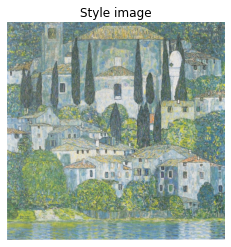

In [1209]:
image_show(content_image, "Content image")
image_show(style_image, "Style image")

### Construct custom model out of vgg19 layers outputs

In [1210]:
vgg19_model = vgg19.VGG19(include_top=False, weights='imagenet')
vgg19_model.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_122 (InputLayer)       [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0     

- Choose one layer for content and five neural network layers for the  style representation

In [1211]:
# Content layers where will pull our feature maps
content_layers = ['block5_conv2'] 
num_content_layers = len(content_layers)

# Style layers we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1',
                'block5_conv1'
               ]
num_style_layers = len(style_layers)

all_layers = content_layers + style_layers
num_all_layers = len(all_layers)

- Define a function that returns custom model with outputs taken by one or more of the vgg19 model layers

In [1212]:
def get_custom_model_from_vgg19_layers(layer_names):
    vgg_model = vgg19.VGG19(include_top=False, weights='imagenet')
    
    vgg_model.trainable = False
        
    outputs = [vgg_model.get_layer(name).output for name in layer_names]
    
    custom_model = Model([vgg_model.input], outputs) 
    
    for layer in custom_model.layers:
        layer.trainable = False
        
    return custom_model

In [1213]:
model = get_custom_model_from_vgg19_layers(content_layers)

In [1214]:
model.summary()

Model: "model_117"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_123 (InputLayer)       [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0 

### Define and create our loss functions

- Define content loss function

In [1215]:
def get_content_loss(base_content, target):
    return tf.reduce_mean(tf.square(base_content - target))

- Generate gram matrix

In [1216]:
def generate_gram_matrix(input_tensor): # input_tensor is of shape ch, n_H, n_W
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor) # Batch matrix multiplication
    input_shape = input_tensor.get_shape()
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32) # Unrolls n_H and n_W
    
    return result/(num_locations)

- Define style loss function

In [1217]:
def get_style_loss(base_style, gram_target):
    gram_style = generate_gram_matrix(base_style)
  
    return tf.reduce_mean(tf.square(gram_style - gram_target))

### Compute the loss and gradients

We train our input image to minimize loss

- Following function scales an image and perform vgg19 preprocessing

In [1218]:
def preprocess_image(image):
    image = image*255.0
    image_preprocessed = vgg19.preprocess_input(image)
    
    return image_preprocessed

- Helper function to compute our content and style feature representations.

In [1219]:
def get_feature_maps(model, image):    
    image_preprocessed = preprocess_image(image)
    
    return model(image_preprocessed)

- Lets test get_feature_maps and generate_gram_matrix functions

In [1220]:
content_custom_model = get_custom_model_from_vgg19_layers(content_layers)
content_features = get_feature_maps(content_custom_model, content_image)

assert content_features.get_shape() == (1, 32, 32, 512)

In [1221]:
style_custom_model = get_custom_model_from_vgg19_layers(style_layers)
style_features = get_feature_maps(style_custom_model, style_image)

assert len(style_features) == num_style_layers

In [1222]:
gram_style_target_features = [generate_gram_matrix(style_feature) for style_feature in style_features]

In [1223]:
for gram_matrix in gram_style_target_features:
    assert len(gram_matrix.get_shape()) == 3

- Compute the total loss.

In [1224]:
def compute_loss(outputs, content_target_features, gram_style_target_features, content_weight, style_weight):
    content_output_features = outputs[:num_content_layers]
    style_output_features = outputs[num_content_layers:]
    
    # Accumulate content losses from all layers 
    content_score = 0
    weight_per_content_layer = 1.0 / float(num_content_layers)
    for target_content, output_content in zip([content_target_features], content_output_features):
        content_score += weight_per_content_layer * get_content_loss(output_content, target_content)
    
    # Accumulate style losses from all layers
    style_score = 0
    weight_per_style_layer = 1.0 / float(num_style_layers)
    for target_style, output_style in zip(gram_style_target_features, style_output_features):
        style_score += weight_per_style_layer * get_style_loss(output_style, target_style)

    total_loss = content_weight * content_score + style_weight * style_score
    
    return total_loss

- Lets create a function that scale the image values between 0 and 1

In [1225]:
def scale_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

- Create a function that execute one training step, calculate gradient and update the initialization image via backpropagation

In [1226]:
@tf.function
def train_step(image, model, optimizer, content_target_features, gram_style_target_features, content_weight, style_weight):
    with tf.GradientTape() as tape:
        outputs = get_feature_maps(model, image)
        loss = compute_loss(outputs, content_target_features, gram_style_target_features, content_weight, style_weight)

    grad = tape.gradient(loss, image)
    optimizer.apply_gradients([(grad, image)])
    image.assign(scale_0_1(image))

- Next function wraps up the whole style transfer flow

In [1227]:
def run_style_transfer(content_path, 
                       style_path,
                       init_image,
                       store_image_path,
                       num_iterations=1001,
                       content_weight=10, 
                       style_weight = 40,
                       learning_rate = 0.02):    
    content_image = read_image(content_path)
    style_image = read_image(style_path)
    
    full_model = get_custom_model_from_vgg19_layers(all_layers)
    content_model = get_custom_model_from_vgg19_layers(content_layers)    
    style_model = get_custom_model_from_vgg19_layers(style_layers)
    
    content_target_features = get_feature_maps(content_model, content_image)
    style_target_features = get_feature_maps(style_model, style_image)
    gram_style_target_features = [generate_gram_matrix(style_feature) for style_feature in style_target_features]
    
    
    # Create our optimizer
    optimizer = Adam(learning_rate=learning_rate)
    
    for i in range(num_iterations):
        train_step(init_image, full_model, optimizer, content_target_features, gram_style_target_features, content_weight, style_weight)
        if(i%100==0):
            print_content_style_and_new_image(content_image, style_image, init_image, i)
            cleaned_generated_image = ((init_image[0].numpy())*255.0).astype('uint8')
            plt.imsave(os.path.join(store_image_path,f"{i}.jpg"), cleaned_generated_image)
    

- Following function prints the content, style and generated images on one row

In [1228]:
def print_content_style_and_new_image(content_image, style_image, init_image, interation):
    plt.figure(figsize=(12,12))
    plt.gca().axes.get_xaxis().set_visible(False)
    plt.gca().axes.get_yaxis().set_visible(False)
    plt.subplot(1, 3, 1)
    image_show(content_image, 'Original Image')
    plt.subplot(1, 3, 2)
    image_show(style_image, 'Style Image')
    plt.subplot(1, 3, 3)
    image_show(init_image, 'New Image - Step'+str(interation))
    plt.axis('off')
    plt.show()    

- We can reuse the logic for running the model only when it's result folder is empty, otherwise load the images from the folder 

In [1229]:
def run_model_or_load_images(content_image_path, style_image_path, generated_image_path, init_image, 
                             num_iterations=1001, content_weight=10, style_weight=40, learning_rate=0.02):
    if not os.path.exists(generated_image_path):
        os.makedirs(generated_image_path)    
    directory_files= os.listdir(generated_image_path)
    if(len(directory_files) == 0):
        run_style_transfer(content_image_path, style_image_path, init_image, generated_image_path, num_iterations, content_weight, style_weight, learning_rate)
    else:
        content_image = read_image(content_image_path)
        style_image = read_image(style_image_path) 

        for file in directory_files:
            generated_image = read_image(os.path.join(generated_image_path, file))
            print_content_style_and_new_image(content_image, style_image, generated_image, file)

- We are ready to execute the model and we are gonna use the content image as an initialization image

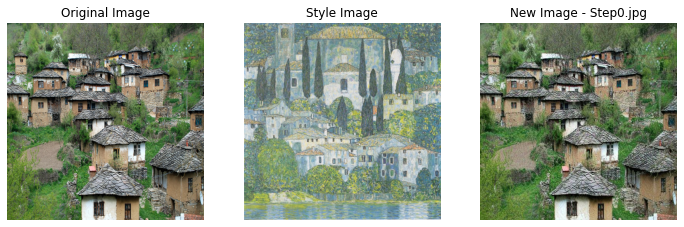

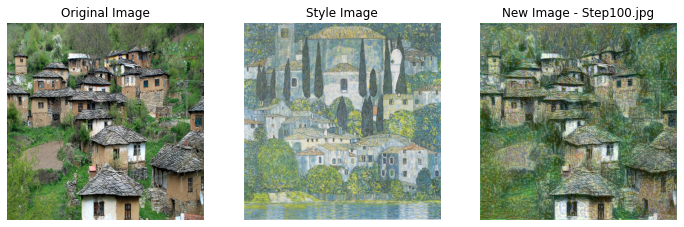

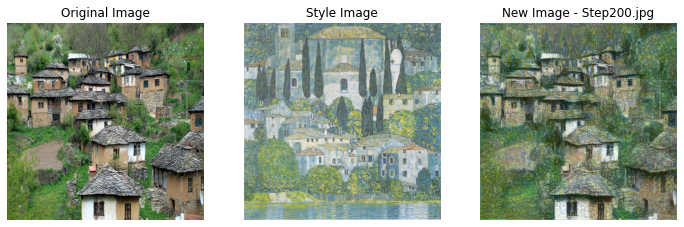

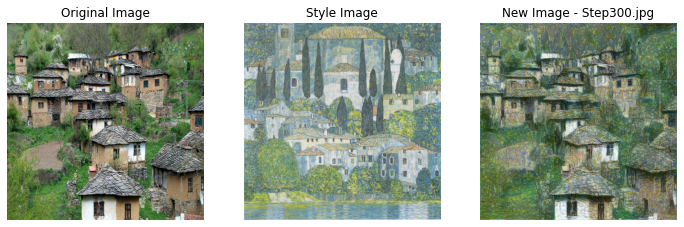

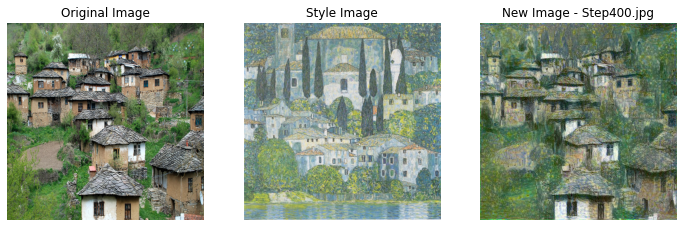

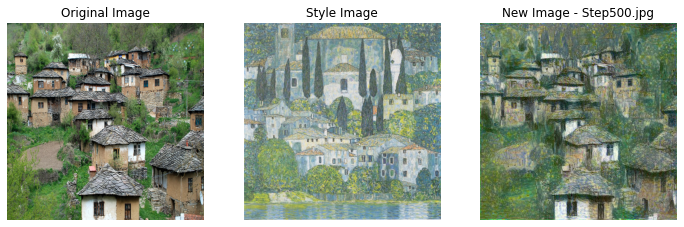

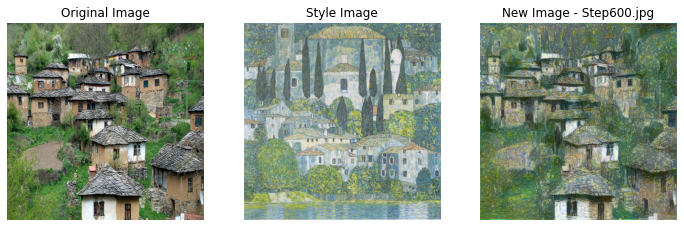

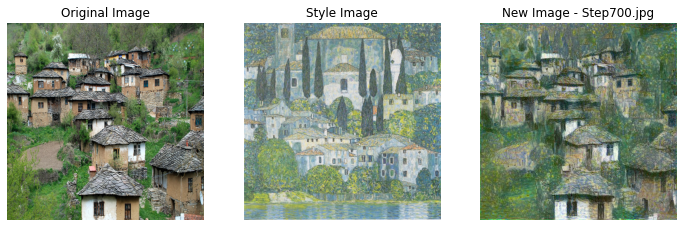

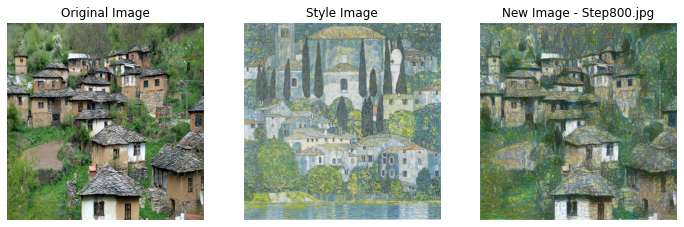

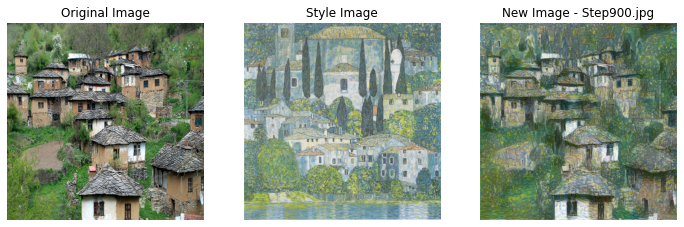

In [1230]:
content_image_path = os.path.join(CONTENT_IMAGES_DIR, "village_001.jpg")
style_image_path = os.path.join(STYLE_IMAGES_DIR, "Gustav_Klimt_2.jpg")
generated_image_path = os.path.join(RESULT_IMAGES_DIR, "content_image_as_seed")
init_image = read_image(content_image_path)
init_image = tf.Variable(init_image)

run_model_or_load_images(content_image_path, style_image_path, generated_image_path, init_image)

- Lets use style image for an initialization image

After the first attempt I saw barely any difference in the generated image, so I increased the learning rate 10 times and content_weight

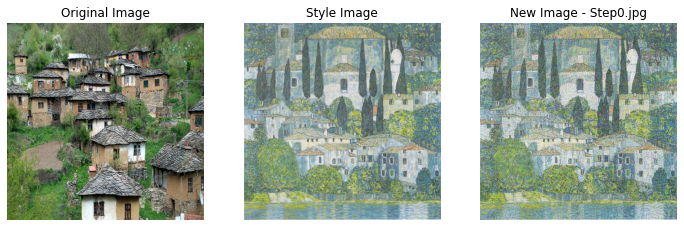

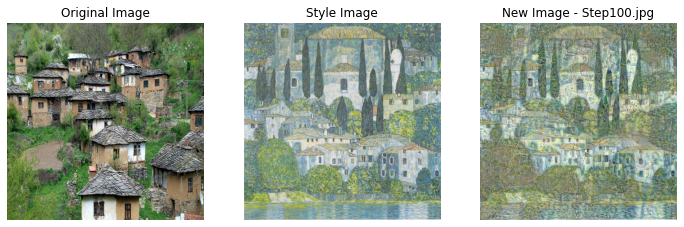

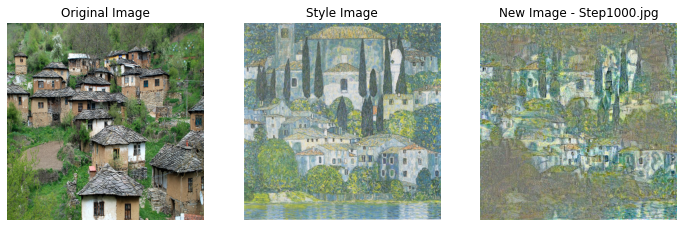

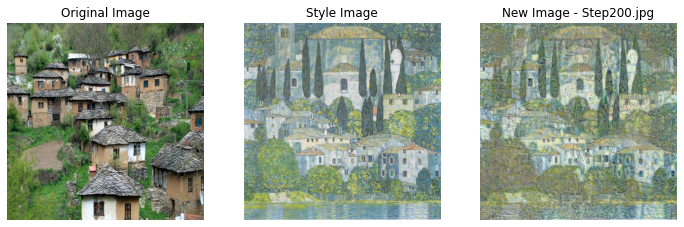

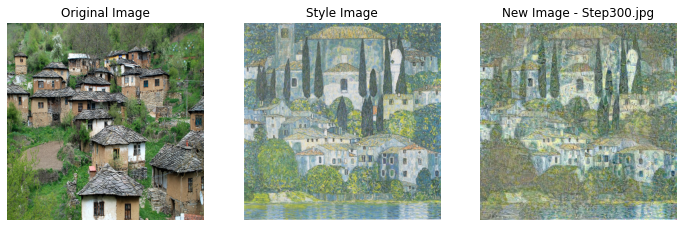

...

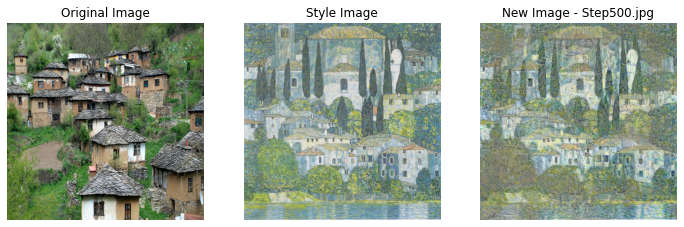

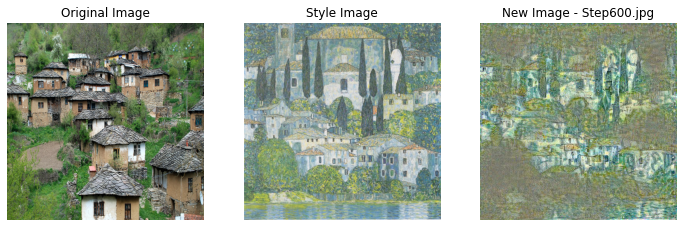

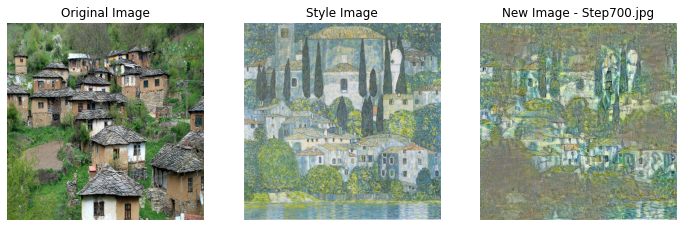

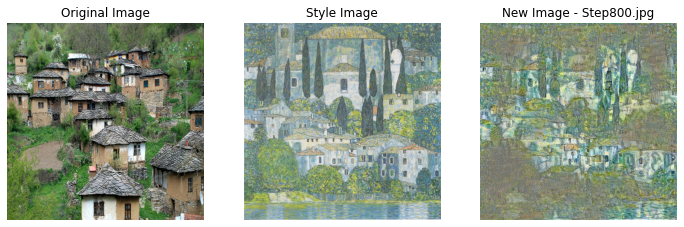

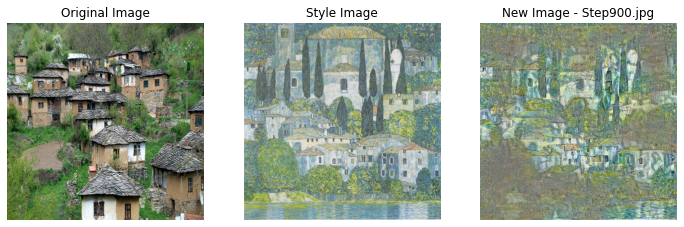

In [1231]:
content_image_path = os.path.join(CONTENT_IMAGES_DIR, "village_001.jpg")
style_image_path = os.path.join(STYLE_IMAGES_DIR, "Gustav_Klimt_2.jpg")
generated_image_path = os.path.join(RESULT_IMAGES_DIR, "style_image_as_seed")
init_image = read_image(style_image_path)
init_image = tf.Variable(init_image)

run_model_or_load_images(content_image_path, style_image_path, generated_image_path, init_image, content_weight=60, style_weight = 40, learning_rate = 0.05)

- Lets try with passing random noise as an initialization image

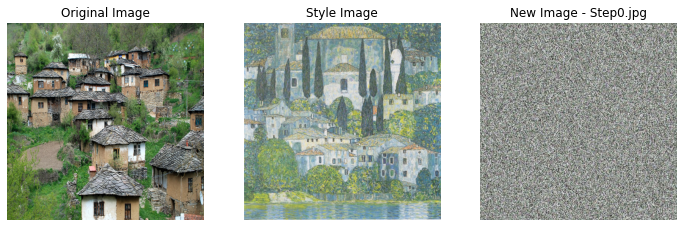

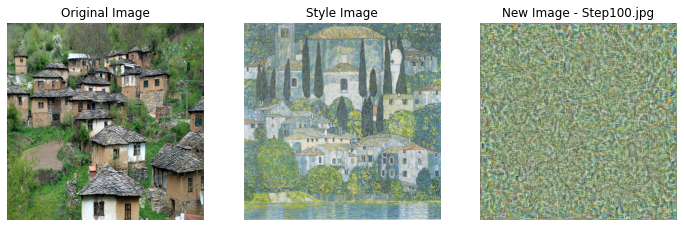

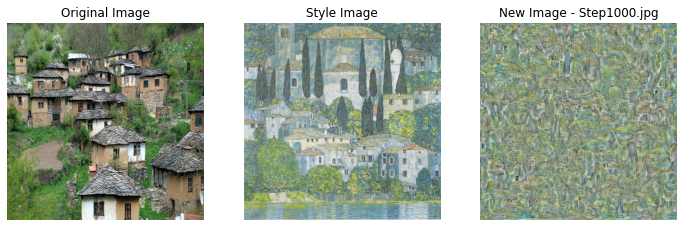

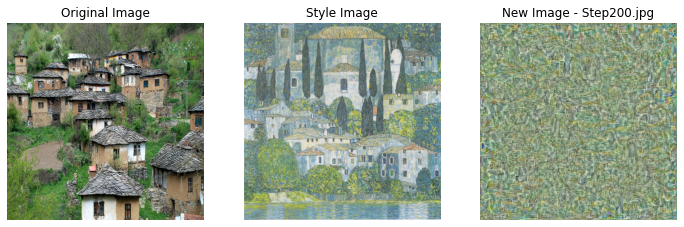

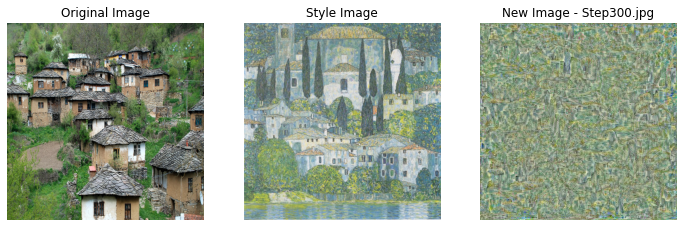

...

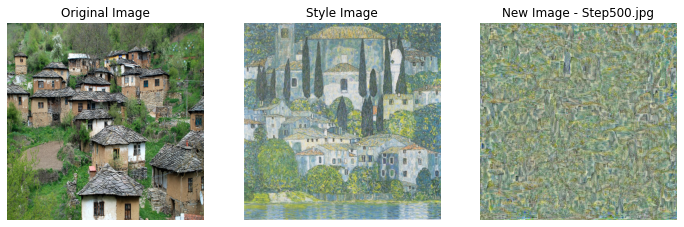

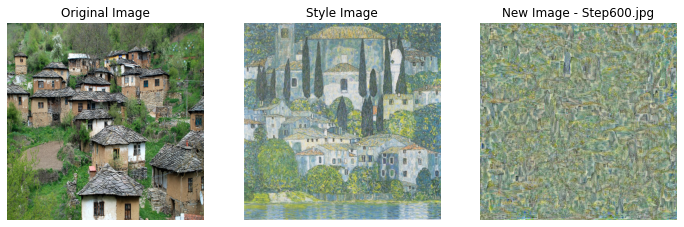

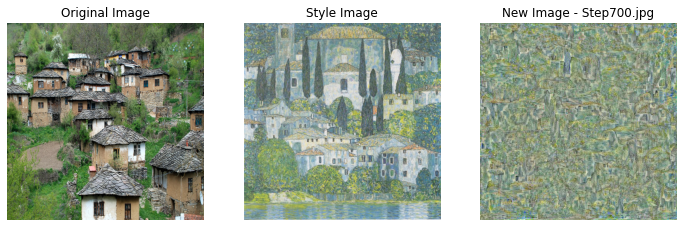

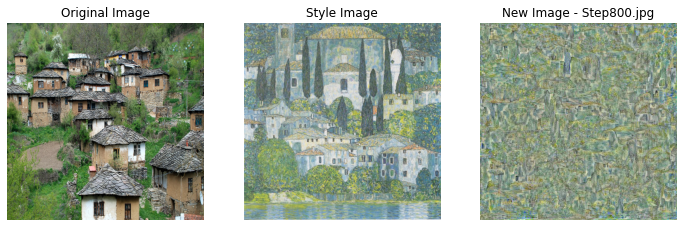

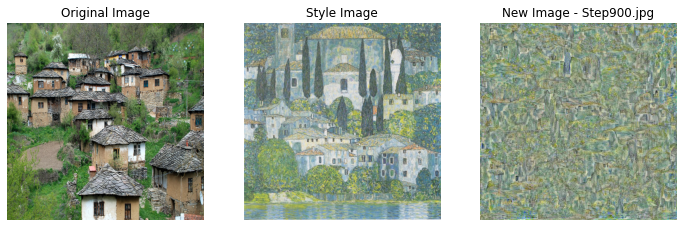

In [1232]:
content_image_path = os.path.join(CONTENT_IMAGES_DIR, "village_001.jpg")
style_image_path = os.path.join(STYLE_IMAGES_DIR, "Gustav_Klimt_2.jpg")

generated_image_path = os.path.join(RESULT_IMAGES_DIR, "random_noise_image_as_seed")
random_noise_path = os.path.join(DATA_DIR, "random_noise.jpg")
init_image = read_image(random_noise_path)
init_image = tf.Variable(init_image)

run_model_or_load_images(content_image_path, style_image_path, generated_image_path, init_image, content_weight=10, style_weight = 40, learning_rate = 0.03)

- Lets try a second time with reduced learning rate

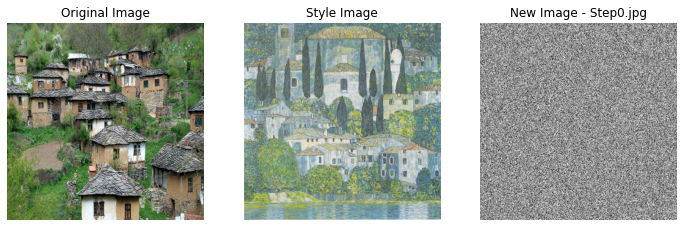

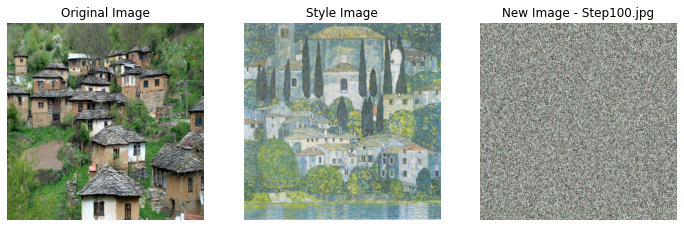

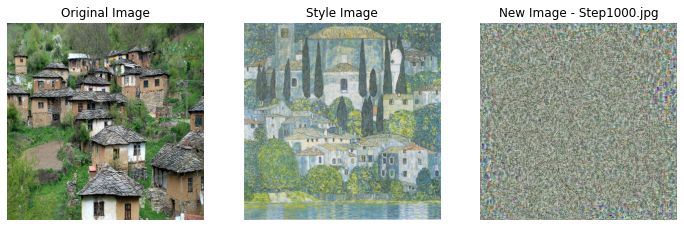

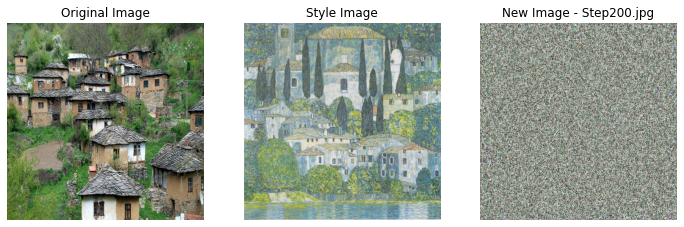

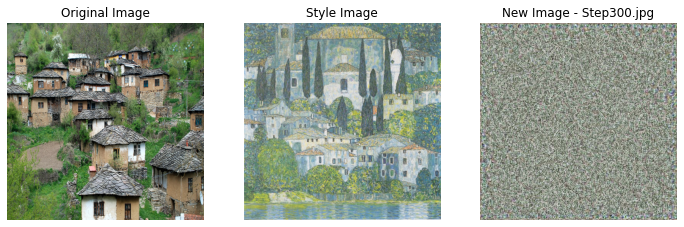

...

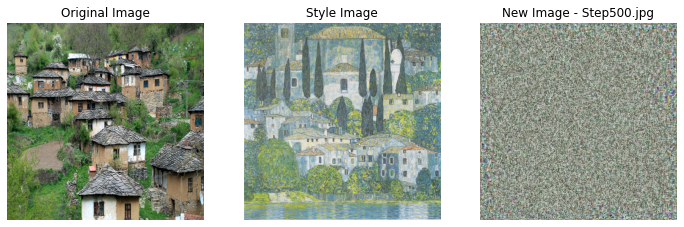

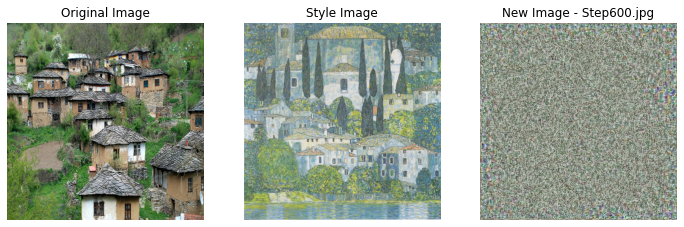

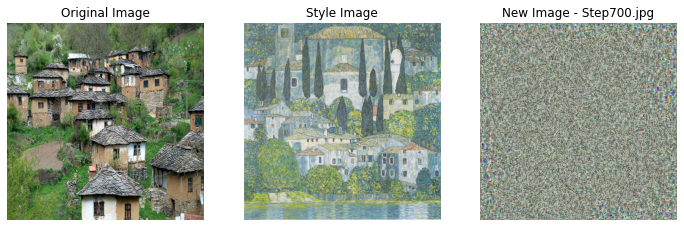

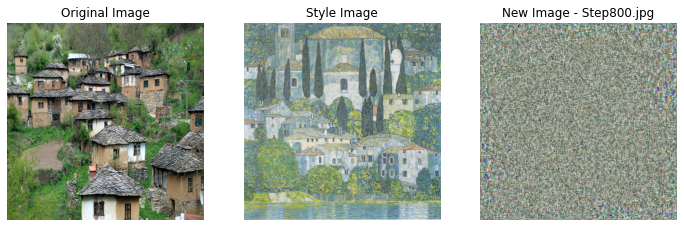

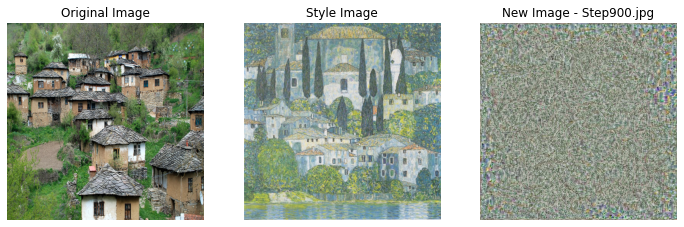

In [1233]:
content_image_path = os.path.join(CONTENT_IMAGES_DIR, "village_001.jpg")
style_image_path = os.path.join(STYLE_IMAGES_DIR, "Gustav_Klimt_2.jpg")

generated_image_path = os.path.join(RESULT_IMAGES_DIR, "random_noise_image_as_seed_2")
random_noise_path = os.path.join(DATA_DIR, "random_noise.jpg")
init_image = read_image(random_noise_path)
init_image = tf.Variable(init_image)

run_model_or_load_images(content_image_path, style_image_path, generated_image_path, init_image, learning_rate = 0.001)

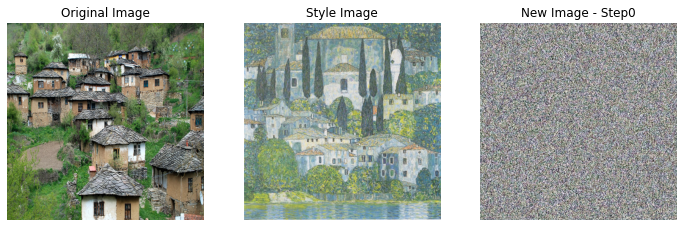

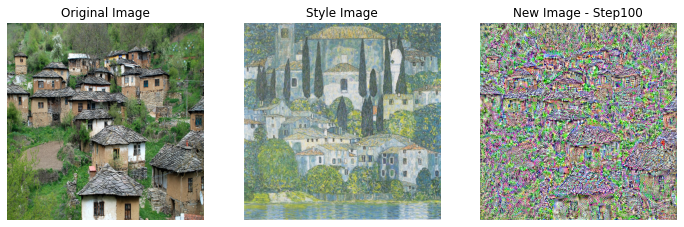

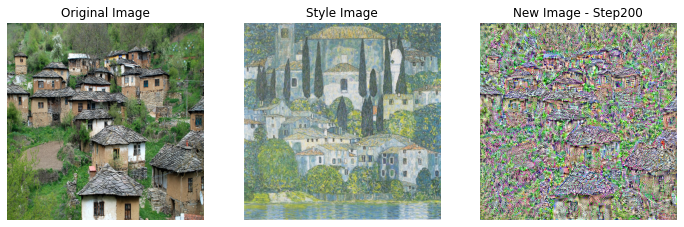

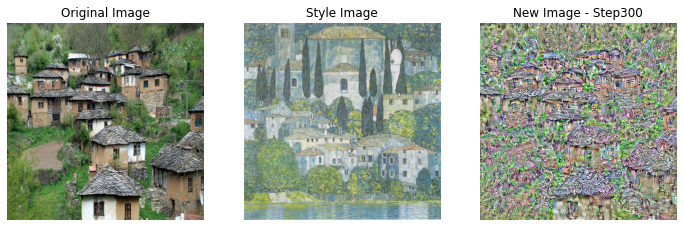

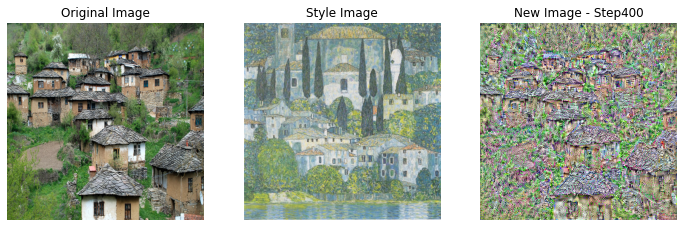

...

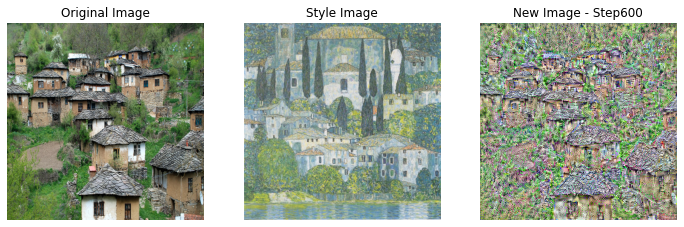

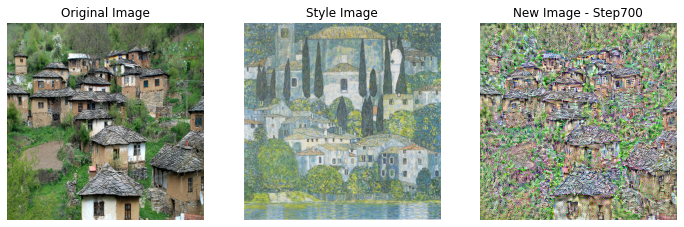

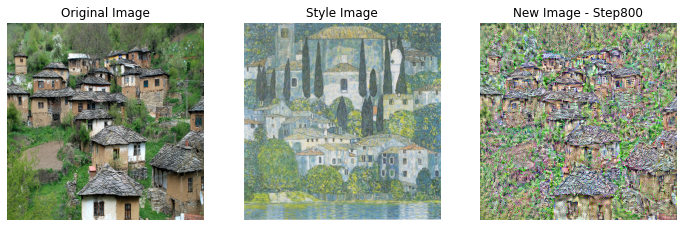

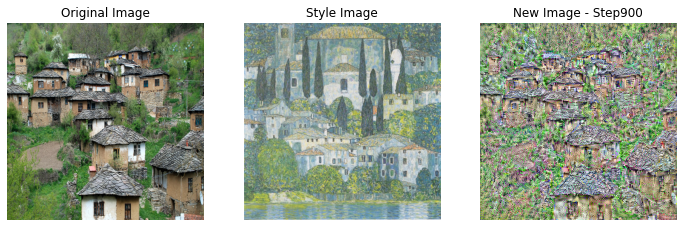

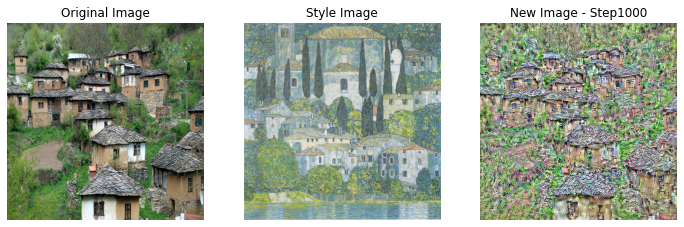

In [1234]:
content_image_path = os.path.join(CONTENT_IMAGES_DIR, "village_001.jpg")
style_image_path = os.path.join(STYLE_IMAGES_DIR, "Gustav_Klimt_2.jpg")

generated_image_path = os.path.join(RESULT_IMAGES_DIR, "random_noise_image_as_seed_big_content_weight")
random_noise_path = os.path.join(DATA_DIR, "random_noise.jpg")
init_image = read_image(random_noise_path)
init_image = tf.Variable(init_image)

run_model_or_load_images(content_image_path, style_image_path, generated_image_path, init_image, content_weight=1000, style_weight = 0, learning_rate = 0.03)

- Lets try to use another input images for content and style

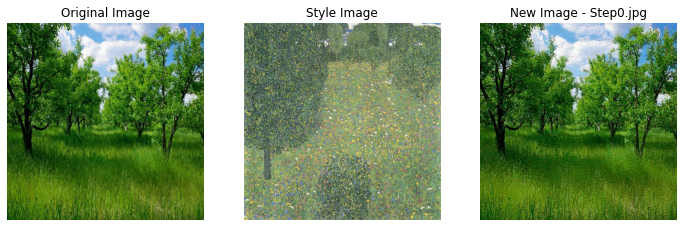

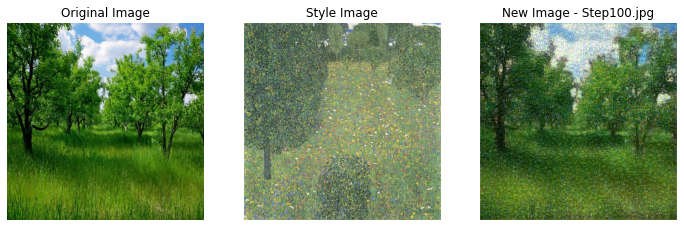

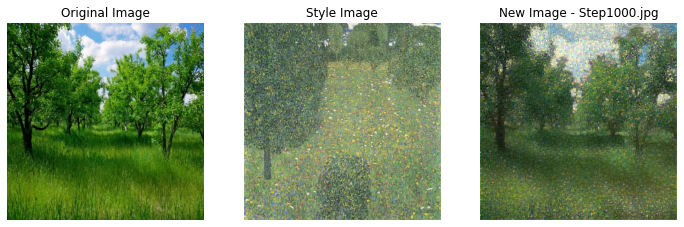

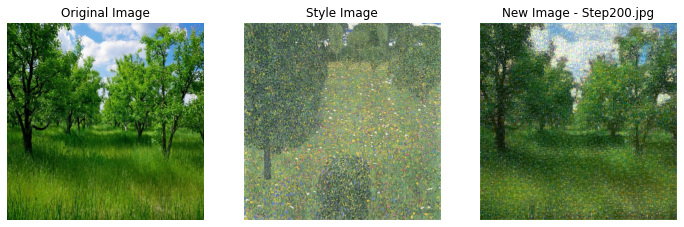

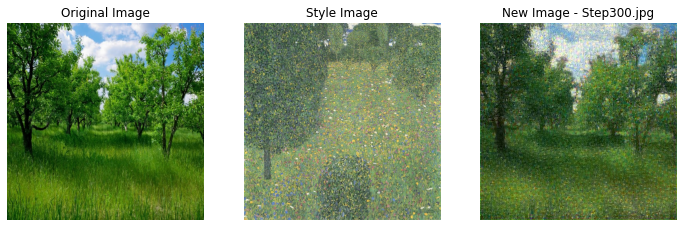

...

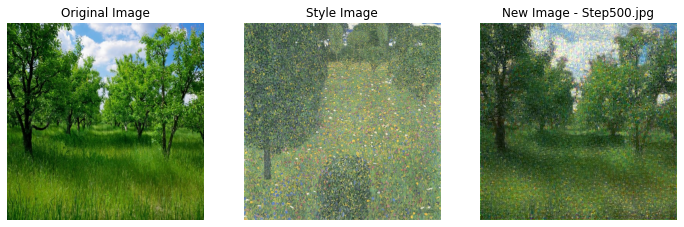

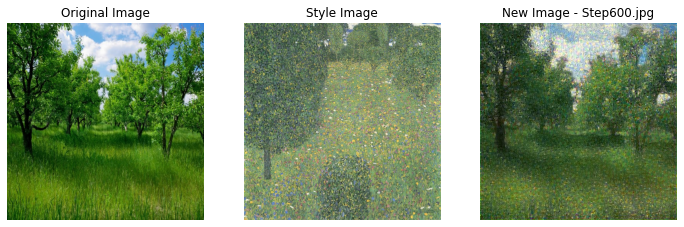

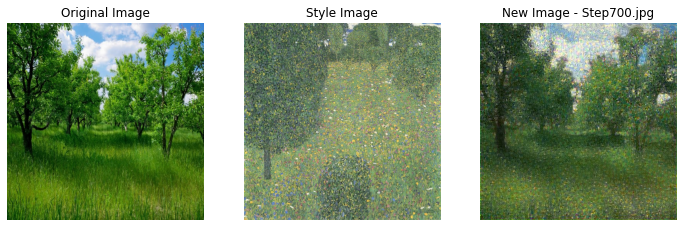

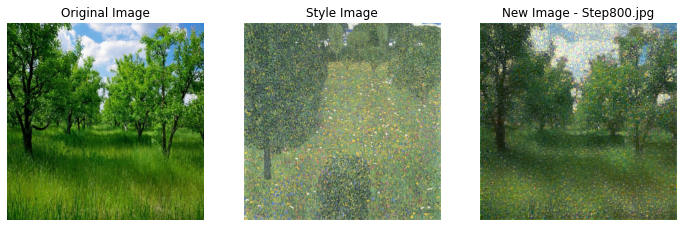

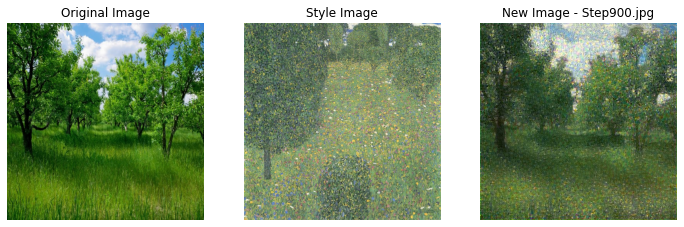

In [1235]:
content_image_path = os.path.join(CONTENT_IMAGES_DIR, "trees.jpg")
style_image_path = os.path.join(STYLE_IMAGES_DIR, "Gustav_Klimt_9.jpg")
generated_image_path = os.path.join(RESULT_IMAGES_DIR, "content_image_as_seed_2")
init_image = read_image(content_image_path)
init_image = tf.Variable(init_image)

run_model_or_load_images(content_image_path, style_image_path, generated_image_path, init_image)

- Lets put this image for another 1001 iterations

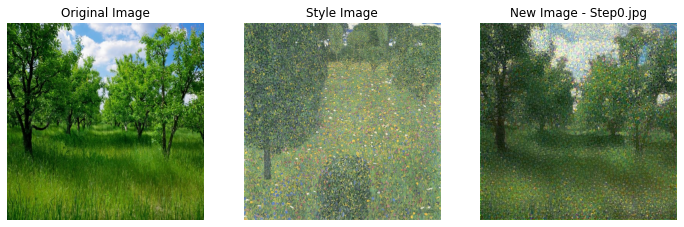

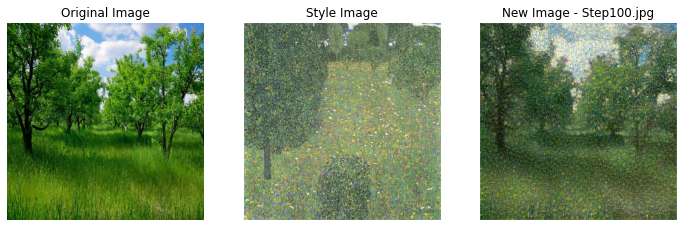

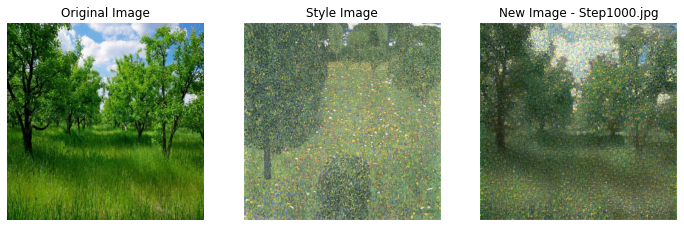

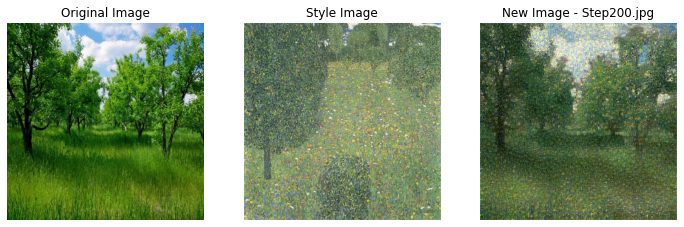

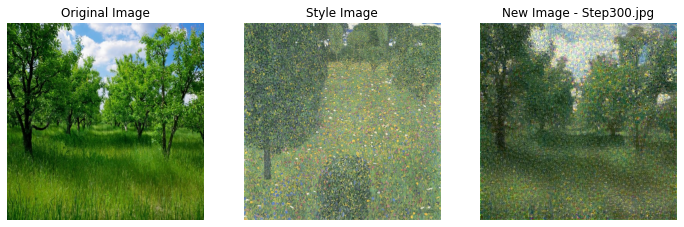

...

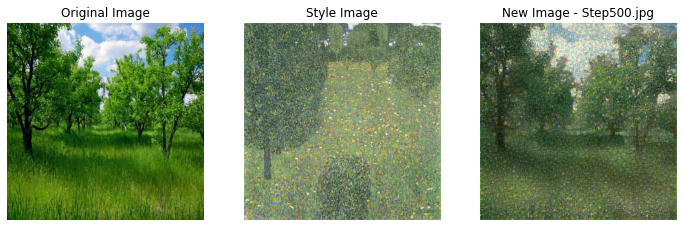

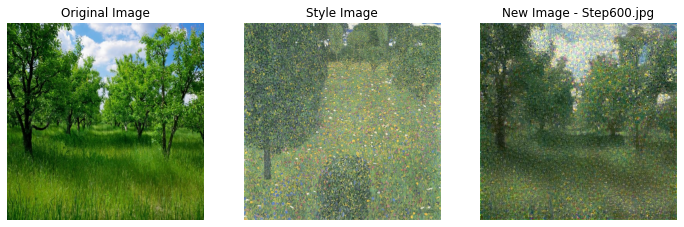

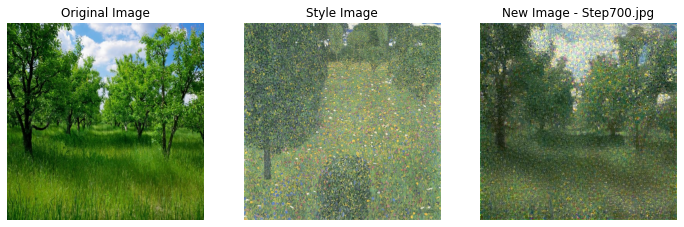

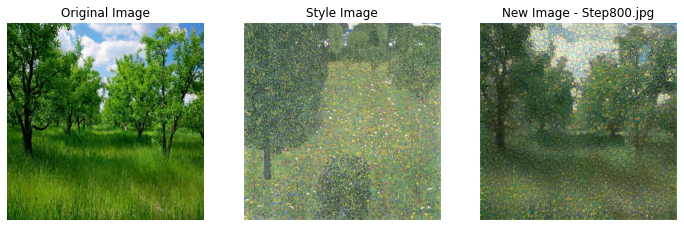

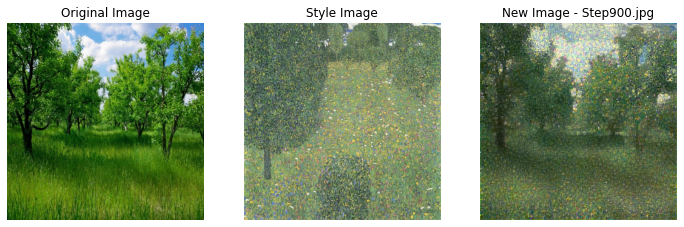

In [1236]:
content_image_path = os.path.join(CONTENT_IMAGES_DIR, "trees.jpg")
style_image_path = os.path.join(STYLE_IMAGES_DIR, "Gustav_Klimt_9.jpg")
generated_image_path = os.path.join(RESULT_IMAGES_DIR, "content_image_as_seed_2_2")
previous_iteration_image_path = os.path.join(RESULT_IMAGES_DIR, "content_image_as_seed_2")
init_image = read_image(os.path.join(previous_iteration_image_path, "1000.jpg"))     
init_image = tf.Variable(init_image) 

run_model_or_load_images(content_image_path, style_image_path, generated_image_path, init_image)

## Conclusion

When we are using content image for initizlization the model is doing a very good job in transfering style to it. 

However when the style iamge or random noise is used as initizlization image the result is failure.
In the original paper written by Lean A. Gatys the generation of the new image by the style image or random noise was successful, so I think either I have error in the loss function implementation or I should reduce the learning rate and try with more iterations.

## References

- https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf
- https://colab.research.google.com/github/tensorflow/models/blob/master/research/nst_blogpost/4_Neural_Style_Transfer_with_Eager_Execution.ipynb
- https://www.kaggle.com/imoore/generate-paintings-by-image-style-transfer